# Collaboration and Competition

---

You are welcome to use this coding environment to train your agent for the project.  Follow the instructions below to get started!

### 1. Start the Environment

Run the next code cell to install a few packages.  This line will take a few minutes to run!

In [2]:
!pip -q install ./python

The environment is already saved in the Workspace and can be accessed at the file path provided below. 

In [3]:
from unityagents import UnityEnvironment
import numpy as np

env = UnityEnvironment(file_name="/data/Tennis_Linux_NoVis/Tennis")

INFO:unityagents:
'Academy' started successfully!
Unity Academy name: Academy
        Number of Brains: 1
        Number of External Brains : 1
        Lesson number : 0
        Reset Parameters :
		
Unity brain name: TennisBrain
        Number of Visual Observations (per agent): 0
        Vector Observation space type: continuous
        Vector Observation space size (per agent): 8
        Number of stacked Vector Observation: 3
        Vector Action space type: continuous
        Vector Action space size (per agent): 2
        Vector Action descriptions: , 


Environments contain **_brains_** which are responsible for deciding the actions of their associated agents. Here we check for the first brain available, and set it as the default brain we will be controlling from Python.

In [4]:
# get the default brain
brain_name = env.brain_names[0]
brain = env.brains[brain_name]

### 2. Examine the State and Action Spaces

Run the code cell below to print some information about the environment.

In [5]:
# reset the environment
env_info = env.reset(train_mode=True)[brain_name]

# number of agents 
num_agents = len(env_info.agents)
print('Number of agents:', num_agents)

# size of each action
action_size = brain.vector_action_space_size
print('Size of each action:', action_size)

# examine the state space 
states = env_info.vector_observations
state_size = states.shape[1]
print('states.shape = ', states.shape)
print('There are {} agents. Each observes a state with length: {}'.format(states.shape[0], state_size))
print('The state for the first agent looks like:', states[0])

Number of agents: 2
Size of each action: 2
states.shape =  (2, 24)
There are 2 agents. Each observes a state with length: 24
The state for the first agent looks like: [ 0.          0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.          0.
  0.          0.         -6.65278625 -1.5        -0.          0.
  6.83172083  6.         -0.          0.        ]


### 3. Take Random Actions in the Environment

In the next code cell, you will learn how to use the Python API to control the agent and receive feedback from the environment.

Note that **in this coding environment, you will not be able to watch the agents while they are training**, and you should set `train_mode=True` to restart the environment.

In [5]:
for i in range(5):                                         # play game for 5 episodes
    env_info = env.reset(train_mode=False)[brain_name]     # reset the environment    
    states = env_info.vector_observations                  # get the current state (for each agent)
    scores = np.zeros(num_agents)                          # initialize the score (for each agent)
    while True:
        actions = np.random.randn(num_agents, action_size) # select an action (for each agent)
        actions = np.clip(actions, -1, 1)                  # all actions between -1 and 1
        env_info = env.step(actions)[brain_name]           # send all actions to tne environment
        next_states = env_info.vector_observations         # get next state (for each agent)
        rewards = env_info.rewards                         # get reward (for each agent)
        dones = env_info.local_done                        # see if episode finished
        scores += env_info.rewards                         # update the score (for each agent)
        states = next_states                               # roll over states to next time step
        if np.any(dones):                                  # exit loop if episode finished
            break
    print('Total score (averaged over agents) this episode: {}'.format(np.mean(scores)))

Total score (averaged over agents) this episode: 0.04500000085681677
Total score (averaged over agents) this episode: -0.004999999888241291
Total score (averaged over agents) this episode: -0.004999999888241291
Total score (averaged over agents) this episode: -0.004999999888241291
Total score (averaged over agents) this episode: -0.004999999888241291


When finished, you can close the environment.

In [ ]:
#env.close()

### 4. It's Your Turn!

Now it's your turn to train your own agent to solve the environment!  A few **important notes**:
- When training the environment, set `train_mode=True`, so that the line for resetting the environment looks like the following:
```python
env_info = env.reset(train_mode=True)[brain_name]
```
- To structure your work, you're welcome to work directly in this Jupyter notebook, or you might like to start over with a new file!  You can see the list of files in the workspace by clicking on **_Jupyter_** in the top left corner of the notebook.
- In this coding environment, you will not be able to watch the agents while they are training.  However, **_after training the agents_**, you can download the saved model weights to watch the agents on your own machine! 

## Approach

We attempt to apply the MADDPG algorithm, potentially with a couple of adjustments, as described in the paper [Multi-Agent Actor-Critic for Mixed Cooperative-Competitive Environments](https://papers.nips.cc/paper/2017/file/68a9750337a418a86fe06c1991a1d64c-Paper.pdf)

Each agent will have its own Critic neural network, to evaluate the policy (output an estimate of the Q value given an input state), and its own Actor network being the trained policy (output an action vector given an input state).
Critic networks of all agents will be trained based on the same input experiences tuples (state, next state, action agent 1, action agent 2, reward agent 1, reward agent 2), where state and next state describe the environment state and stateof both agents. That's why the paper talks about having a "centralized critic".
Agent networks are trained based on the local observation of each agent.

As for DDPG, we maintain both an online and a target network for each Actor and each Critic network. The "online" network is the network being trained, while the target network is a copy of the online network from N steps before remaining unchanged for a couple of steps to serve as target in the loss expression.

In [6]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import random
from collections import deque

In [7]:
full_state_size = num_agents * state_size
full_action_size = num_agents * action_size
print('Full state size: ', full_state_size)
print('Full action size: ', full_action_size)

Full state size:  48
Full action size:  4


In [14]:
class Actor(nn.Module):
    def __init__(self, actor_state_size, actor_action_size):
        super(Actor, self).__init__()
        self.actor_state_size = actor_state_size
        self.hidden1 = nn.Sequential(
            nn.Linear(actor_state_size, 300),
            #nn.Dropout(0.2),
            nn.ReLU()
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(300, 300),
            #nn.Dropout(0.2),
            nn.ReLU()
        )
        self.output = nn.Sequential(
            nn.Linear(300, actor_action_size),
            nn.Tanh()
        )
        
    def forward(self, x):
        batch_size = x.shape[0]
        assert(x.shape == (batch_size, self.actor_state_size))
        x = self.hidden1(x)
        x = self.hidden2(x)
        return self.output(x)

In [15]:
class Critic(nn.Module):
    def __init__(self, actor_state_size, actor_action_size, nb_agents):
        super(Critic, self).__init__()
        self.nb_agents = nb_agents
        self.actor_state_size = actor_state_size
        self.actor_action_size = actor_action_size
        self.hidden1s = nn.Sequential(
            nn.Linear(nb_agents*actor_state_size, 100),
            #nn.Dropout(0.2)
            #nn.ReLU()
        ) 
        self.hidden1 = nn.Sequential(
            nn.Linear(100+nb_agents*actor_action_size, 300),
            #nn.Dropout(0.2),
            nn.ReLU()
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(300, 200),
            #nn.Dropout(0.2),
            nn.ReLU()
        )
        self.output = nn.Sequential(
            nn.Linear(200, 1)
        )
        
    def forward(self, states, actions):
        batch_size = states.shape[0]
        assert(states.shape == (batch_size, self.nb_agents, self.actor_state_size))
        assert(actions.shape == (batch_size, self.nb_agents, self.actor_action_size))
        flattened_states = states.flatten(start_dim=1)
        flattened_actions = actions.flatten(start_dim=1)
        xs = self.hidden1s(flattened_states.float())
        x = self.hidden1(torch.cat((xs, flattened_actions), dim=1))
        x = self.hidden2(x)
        return self.output(x)

In [16]:
import copy

class OUNoise:
    """Ornstein-Uhlenbeck process."""

    def __init__(self, size, seed, mu=0., theta=0.15, sigma=0.5):
        """Initialize parameters and noise process."""
        self.mu = mu * np.ones(size)
        self.theta = theta
        self.sigma = sigma
        self.seed = random.seed(seed)
        self.reset()

    def reset(self):
        """Reset the internal state (= noise) to mean (mu)."""
        self.state = copy.copy(self.mu)

    def sample(self, decay_factor=1.0):
        """Update internal state and return it as a noise sample."""
        x = self.state
        #dx = self.theta * (self.mu - x) + self.sigma * np.array([random.random() for i in range(len(x))])
        decay_factor = max(decay_factor, 0.01)
        dx = decay_factor * (self.theta * (self.mu - x) + self.sigma * np.random.randn(len(x)))
        self.state = x + dx
        return self.state

In [20]:
from collections import namedtuple

UPDATE_EVERY = 20
NB_UPDATES = 5
LR_ACTOR = 3e-5
LR_CRITIC = 3e-5
TAU = 1e-2 # for soft update of target parameters
BUFFER_SIZE = 10000

NetworkTuple = namedtuple('NetworkTuple', ['online', 'target', 'optimizer'])

class Agent():
    def __init__(self, batch_size, seed, nb_agents, state_size, action_size):
        self.seed = random.seed(seed)
        self.batch_size = batch_size
        self.critics = []
        self.actors = []
        self.nb_agents = nb_agents
        self.state_size = state_size
        self.action_size = action_size
        self.t_step = 0
        for i in range(nb_agents):
            critic_online = Critic(state_size, action_size, nb_agents).to(device)
            critic_target = Critic(state_size, action_size, nb_agents).to(device)
            optimizer_critic = optim.Adam(critic_online.parameters(), lr=LR_CRITIC)
            actor_online = Actor(state_size, action_size).to(device)
            actor_target = Actor(state_size, action_size).to(device)
            optimizer_actor = optim.Adam(actor_online.parameters(), lr=LR_ACTOR)
            self.critics.append(NetworkTuple(critic_online, critic_target, optimizer_critic))
            self.actors.append(NetworkTuple(actor_online, actor_target, optimizer_actor))
        self.experiences_buffer = deque(maxlen=BUFFER_SIZE)
        self.noise = OUNoise((nb_agents, action_size), seed)
        
    def act(self, local_states, i_episode, add_noise=True):
        for actor in self.actors:
            actor.online.eval()
        with torch.no_grad():
            actions = []
            for actor, local_state in zip(self.actors, local_states):
                action = actor.online(local_state.unsqueeze(0))
                actions.append(action.squeeze(0).cpu().data.numpy())
            actions = np.stack(actions)
        for actor in self.actors:
            actor.online.train()
        if add_noise:
            actions += self.noise.sample(0.999**i_episode)
        return np.clip(actions, -1, 1)    
        
    def step(self, states, actions, next_states, rewards, done):
        self.experiences_buffer.append((states, actions, next_states, rewards, done))
        self.t_step += 1
        if (len(self.experiences_buffer) >= self.batch_size) and (self.t_step % UPDATE_EVERY == 0):
            critic_losses = []
            actor_losses = []
            for i in range(NB_UPDATES):
                experiences = self.collect_experiences()
                for j in range(self.nb_agents):
                    loss_critic, loss_actor = self.learn(experiences, 0.99, self.t_step, j)
                    critic_losses.append(loss_critic)
                    actor_losses.append(loss_actor)
            print('Avg critic losses: ', torch.mean(torch.vstack(critic_losses)))
            print('Avg actor losses: ', torch.mean(torch.vstack(actor_losses)))
            for actor, critic in zip(self.actors, self.critics):
                self.soft_update(critic.online, critic.target, TAU)
                self.soft_update(actor.online, actor.target, TAU)
            self.noise.reset()
            
    def reset(self):
        #self.t_step = 0
        #self.noise.reset()
        pass
            
    def learn(self, experiences, gamma, t_step, agent_idx):
        states = (torch.stack([e[0] for e in experiences])).float().to(device)
        actions = (torch.stack([e[1] for e in experiences])).float().to(device)
        next_states = (torch.stack([e[2] for e in experiences])).float().to(device)
        rewards = (torch.vstack([e[3] for e in experiences])).float().to(device)
        dones = (torch.vstack([e[4] for e in experiences])).float().to(device)
        
        assert(states.shape == (self.batch_size, self.nb_agents, self.state_size))
        assert(actions.shape == (self.batch_size, self.nb_agents, self.action_size))
        assert(next_states.shape == (self.batch_size, self.nb_agents, self.state_size))
        assert(rewards.shape == (self.batch_size, self.nb_agents))
        
        critic = self.critics[agent_idx]
        actor = self.actors[agent_idx]
        
        assert(states.shape == (self.batch_size, self.nb_agents, self.state_size))
        assert(next_states.shape == (self.batch_size, self.nb_agents, self.state_size))
        states_t = states.transpose(0, 1)
        next_states_t = next_states.transpose(0, 1)
        assert(states_t.shape == (self.nb_agents, self.batch_size, self.state_size))
        assert(next_states_t.shape == (self.nb_agents, self.batch_size, self.state_size))
        
        # Train critic
        next_actions = torch.stack([actor.target(next_state) for actor, next_state in zip(self.actors, next_states_t)]).transpose(0, 1).detach()
        reward = rewards[:, agent_idx].reshape((batch_size, -1)).detach()
        Q_target_next = critic.target(next_states, next_actions).detach()
        Q_target = reward + (gamma * Q_target_next * (1 - dones)).detach()
        Q_online = critic.online(states, actions)
        
        assert(Q_online.shape == (batch_size, 1))
        assert(Q_online.shape == Q_target.shape)
        loss_critic = F.smooth_l1_loss(Q_online, Q_target)
        critic.optimizer.zero_grad()
        loss_critic.backward(retain_graph=True)
        critic.optimizer.step()
        
        # Train actor
        predicted_actions = torch.stack([actor.online(state) for actor, state in zip(self.actors, states_t)]).transpose(0, 1)
        actor.optimizer.zero_grad()
        loss_actor = -critic.online(states, predicted_actions).mean()
        #loss_actor = -critic.online(states, predicted_actions).sum()
        loss_actor.backward(inputs=list(actor.online.parameters()), retain_graph=True)
        actor.optimizer.step()
        
        return (loss_critic, loss_actor)
        
    def collect_experiences(self):
        experiences = random.choices(self.experiences_buffer, k=self.batch_size)
        return experiences
        
    def soft_update(self, local_model, target_model, tau):
        for target_param, local_param in zip(target_model.parameters(), local_model.parameters()):
            target_param.data.copy_(tau*local_param.data + (1.0-tau)*target_param.data)

In [26]:
from collections import namedtuple

UPDATE_EVERY = 5
NB_UPDATES = 5
LR_ACTOR = 5e-5
LR_CRITIC = 5e-5
TAU = 5e-2 # for soft update of target parameters
BUFFER_SIZE = 100000

NetworkTuple = namedtuple('NetworkTuple', ['online', 'target', 'optimizer'])

class AgentV2():
    def __init__(self, batch_size, seed, nb_agents, state_size, action_size):
        self.seed = random.seed(seed)
        self.batch_size = batch_size
        self.actors = []
        self.nb_agents = nb_agents
        self.state_size = state_size
        self.action_size = action_size
        self.t_step = 0
        self.critic_online = Critic(state_size, action_size, nb_agents).to(device)
        self.critic_target = Critic(state_size, action_size, nb_agents).to(device)
        self.optimizer_critic = optim.Adam(self.critic_online.parameters(), lr=LR_CRITIC)
        for i in range(nb_agents):
            actor_online = Actor(state_size, action_size).to(device)
            actor_target = Actor(state_size, action_size).to(device)
            optimizer_actor = optim.Adam(actor_online.parameters(), lr=LR_ACTOR)
            self.actors.append(NetworkTuple(actor_online, actor_target, optimizer_actor))
        self.experiences_buffer = deque(maxlen=BUFFER_SIZE)
        self.noise = OUNoise((nb_agents, action_size), seed)
        
    def act(self, local_states, i_episode, add_noise=True):
        for actor in self.actors:
            actor.online.eval()
        with torch.no_grad():
            actions = []
            for actor, local_state in zip(self.actors, local_states):
                action = actor.online(local_state.unsqueeze(0))
                actions.append(action.squeeze(0).cpu().data.numpy())
            actions = np.stack(actions)
        for actor in self.actors:
            actor.online.train()
        if add_noise:
            actions += self.noise.sample(0.999**i_episode)
        return np.clip(actions, -1, 1)    
        
    def step(self, states, actions, next_states, rewards, done):
        self.experiences_buffer.append((states, actions, next_states, rewards, done))
        self.t_step += 1
        if (len(self.experiences_buffer) >= self.batch_size) and (self.t_step % UPDATE_EVERY == 0):
            critic_losses = []
            actor_losses = []
            for i in range(NB_UPDATES):
                experiences = self.collect_experiences()
                loss_critic, loss_actor = self.learn(experiences, 0.99, self.t_step)
                critic_losses.append(loss_critic)
                actor_losses.append(loss_actor)
            print('Avg critic losses: ', torch.mean(torch.vstack(critic_losses)))
            print('Avg actor losses: ', torch.mean(torch.vstack(actor_losses)))
            for actor in self.actors:
                self.soft_update(actor.online, actor.target, TAU)
            self.soft_update(self.critic_online, self.critic_target, TAU)
            self.noise.reset()
            
    def reset(self):
        #self.t_step = 0
        self.noise.reset()
            
    def learn(self, experiences, gamma, t_step):
        states = (torch.stack([e[0] for e in experiences])).float().to(device)
        actions = (torch.stack([e[1] for e in experiences])).float().to(device)
        next_states = (torch.stack([e[2] for e in experiences])).float().to(device)
        rewards = (torch.vstack([e[3] for e in experiences])).float().to(device)
        dones = (torch.vstack([e[4] for e in experiences])).float().to(device)
        
        assert(states.shape == (self.batch_size, self.nb_agents, self.state_size))
        assert(actions.shape == (self.batch_size, self.nb_agents, self.action_size))
        assert(next_states.shape == (self.batch_size, self.nb_agents, self.state_size))
        assert(rewards.shape == (self.batch_size, self.nb_agents))
        assert(dones.shape == (self.batch_size, self.nb_agents))
        
        assert(states.shape == (self.batch_size, self.nb_agents, self.state_size))
        assert(next_states.shape == (self.batch_size, self.nb_agents, self.state_size))
        states_t = states.transpose(0, 1)
        next_states_t = next_states.transpose(0, 1)
        assert(states_t.shape == (self.nb_agents, self.batch_size, self.state_size))
        assert(next_states_t.shape == (self.nb_agents, self.batch_size, self.state_size))
        
        # Train centralized critic
        next_actions = torch.stack([actor.target(next_state) for actor, next_state in zip(self.actors, next_states_t)]).transpose(0, 1).detach()
        Q_target_next = self.critic_target(next_states, next_actions).detach()
        with torch.no_grad():
            Q_target = torch.hstack([rewards[:, i].unsqueeze(1) + (gamma * Q_target_next * (1 - dones[:, i].unsqueeze(1))) for i in range(self.nb_agents)])
        #Q_target = rewards + (gamma * Q_target_next * (1 - dones)).detach()
        Q_online = self.critic_online(states, actions)
        
        assert(Q_online.shape == (batch_size, 1))
        assert(Q_target.shape == (batch_size, self.nb_agents))
        self.optimizer_critic.zero_grad()
        #loss_critic = torch.Tensor([0])
        #for i in range(self.nb_agents):
        #    loss_critic += F.smooth_l1_loss(Q_online, Q_target[:, i].unsqueeze(1)) / self.nb_agents
        loss_critic = F.smooth_l1_loss(Q_online.expand(batch_size, self.nb_agents), Q_target)
        loss_critic.backward(retain_graph=True)
        self.optimizer_critic.step()
        
        loss_actor = torch.Tensor([0])
        # Train actors
        for idx_agent in range(self.nb_agents):
            actor = self.actors[idx_agent]
            actor.optimizer.zero_grad()
            detachv = [lambda t: t if i == idx_agent else t.detach() for i in range(self.nb_agents)]
            #predicted_actions = torch.stack([d(actor.online(state)) for d, actor, state in zip(detachv, self.actors, states_t)]).transpose(0, 1)
            predicted_actions = torch.stack([actor.online(state) for actor, state in zip(self.actors, states_t)]).transpose(0, 1)
            loss_actor = -self.critic_online(states, predicted_actions).mean()
            loss_actor.backward(inputs=list(actor.online.parameters()), retain_graph=True)
            #loss_actor.backward(retain_graph=True)
            actor.optimizer.step()
        
        return (loss_critic, loss_actor)
        
    def collect_experiences(self):
        experiences = random.choices(self.experiences_buffer, k=self.batch_size)
        return experiences
        
    def soft_update(self, local_model, target_model, tau):
        for target_param, local_param in zip(target_model.parameters(), local_model.parameters()):
            target_param.data.copy_(tau*local_param.data + (1.0-tau)*target_param.data)

In [10]:
from collections import namedtuple

UPDATE_EVERY = 1
NB_UPDATES = 1
LR_ACTOR = 5e-5
LR_CRITIC = 5e-5
TAU = 1e-2 # for soft update of target parameters
BUFFER_SIZE = 100000

NetworkTuple = namedtuple('NetworkTuple', ['online', 'target', 'optimizer'])

# Variant of AgentV2 with a single actor
class AgentV3():
    def __init__(self, batch_size, seed, nb_agents, state_size, action_size):
        self.seed = random.seed(seed)
        self.batch_size = batch_size
        self.actors = []
        self.nb_agents = nb_agents
        self.state_size = state_size
        self.action_size = action_size
        self.t_step = 0
        self.critic_online = Critic(state_size, action_size, nb_agents).to(device)
        self.critic_target = Critic(state_size, action_size, nb_agents).to(device)
        self.critic_online.train()
        self.critic_target.eval()
        self.optimizer_critic = optim.Adam(self.critic_online.parameters(), lr=LR_CRITIC)
        self.actor_online = Actor(state_size, action_size).to(device)
        self.actor_target = Actor(state_size, action_size).to(device)
        self.actor_online.train()
        self.actor_target.eval()
        self.optimizer_actor = optim.Adam(self.actor_online.parameters(), lr=LR_ACTOR)
        self.experiences_buffer = deque(maxlen=BUFFER_SIZE)
        self.noise = OUNoise((nb_agents, action_size), seed)
        
    def act(self, local_states, i_episode, add_noise=True):
        self.actor_online.eval()
        with torch.no_grad():
            actions = np.stack([self.actor_online(local_state.unsqueeze(0)).squeeze(0).cpu().data.numpy() for local_state in local_states])
        self.actor_online.train()
        if add_noise:
            actions += self.noise.sample(0.999**i_episode)
        return np.clip(actions, -1, 1)    
        
    def step(self, states, actions, next_states, rewards, done):
        self.experiences_buffer.append((states, actions, next_states, rewards, done))
        self.t_step += 1
        if (len(self.experiences_buffer) >= self.batch_size) and (self.t_step % UPDATE_EVERY == 0):
            critic_losses = []
            actor_losses = []
            for i in range(NB_UPDATES):
                experiences = self.collect_experiences()
                loss_critic, loss_actor = self.learn(experiences, 0.99, self.t_step)
                critic_losses.append(loss_critic)
                actor_losses.append(loss_actor)
            print('Avg critic losses: ', torch.mean(torch.vstack(critic_losses)))
            print('Avg actor losses: ', torch.mean(torch.vstack(actor_losses)))
            self.soft_update(self.actor_online, self.actor_target, TAU)
            self.soft_update(self.critic_online, self.critic_target, TAU)
            self.noise.reset()
            
    def reset(self):
        #self.t_step = 0
        self.noise.reset()
            
    def learn(self, experiences, gamma, t_step):
        states = (torch.stack([e[0] for e in experiences])).float().to(device)
        actions = (torch.stack([e[1] for e in experiences])).float().to(device)
        next_states = (torch.stack([e[2] for e in experiences])).float().to(device)
        rewards = (torch.vstack([e[3] for e in experiences])).float().to(device)
        dones = (torch.vstack([e[4] for e in experiences])).float().to(device)
        
        assert(states.shape == (self.batch_size, self.nb_agents, self.state_size))
        assert(actions.shape == (self.batch_size, self.nb_agents, self.action_size))
        assert(next_states.shape == (self.batch_size, self.nb_agents, self.state_size))
        assert(rewards.shape == (self.batch_size, self.nb_agents))
        assert(dones.shape == (self.batch_size, self.nb_agents))
        
        assert(states.shape == (self.batch_size, self.nb_agents, self.state_size))
        assert(next_states.shape == (self.batch_size, self.nb_agents, self.state_size))
        states_t = states.transpose(0, 1)
        next_states_t = next_states.transpose(0, 1)
        assert(states_t.shape == (self.nb_agents, self.batch_size, self.state_size))
        assert(next_states_t.shape == (self.nb_agents, self.batch_size, self.state_size))
        
        # Train centralized critic
        next_actions = torch.stack([self.actor_target(next_state) for next_state in next_states_t]).transpose(0, 1).detach()
        Q_target_next = self.critic_target(next_states, next_actions).detach()
        with torch.no_grad():
            Q_target = torch.hstack([rewards[:, i].unsqueeze(1) + (gamma * Q_target_next * (1 - dones[:, i].unsqueeze(1))) for i in range(self.nb_agents)])
        Q_online = self.critic_online(states, actions)
        
        assert(Q_online.shape == (batch_size, 1))
        assert(Q_target.shape == (batch_size, self.nb_agents))
        self.optimizer_critic.zero_grad()
        loss_critic = F.smooth_l1_loss(Q_online.expand(batch_size, self.nb_agents), Q_target)
        loss_critic.backward()
        self.optimizer_critic.step()
        
        loss_actor = torch.Tensor([0])
        # Train actor
        self.optimizer_actor.zero_grad()
        predicted_actions = torch.stack([self.actor_online(state) for state in states_t]).transpose(0, 1)
        loss_actor = -self.critic_online(states, predicted_actions).mean()
        loss_actor.backward()
        self.optimizer_actor.step()
        
        return (loss_critic, loss_actor)
        
    def collect_experiences(self):
        experiences = random.choices(self.experiences_buffer, k=self.batch_size)
        return experiences
        
    def soft_update(self, local_model, target_model, tau):
        for target_param, local_param in zip(target_model.parameters(), local_model.parameters()):
            target_param.data.copy_(tau*local_param.data + (1.0-tau)*target_param.data)

In [11]:
def run_episode(agent, i_episode, num_agents):
    env_info = env.reset(train_mode=True)[brain_name]
    scores = np.zeros(num_agents)
    states = torch.from_numpy(env_info.vector_observations).float().to(device)
    i = 0
    while True: # episodic task => no need to cap the number of time steps
        actions = agent.act(states, i_episode)
        env_info = env.step(actions)[brain_name]
        next_states = torch.from_numpy(env_info.vector_observations).float().to(device)
        rewards = torch.FloatTensor(env_info.rewards).to(device)
        dones = torch.FloatTensor(env_info.local_done).to(device)
        agent.step(states, torch.from_numpy(actions).float().to(device), next_states, rewards, dones)
        scores += env_info.rewards
        states = next_states
        if np.any(env_info.local_done):
            print('episode done in ', i, ' time steps; scores: ', scores)
            break
        i += 1
    episode_score = np.max(scores)
    return episode_score

In [12]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [17]:
batch_size = 256
seed = 10
agent = AgentV3(batch_size, seed, num_agents, state_size, action_size)

In [18]:
from workspace_utils import keep_awake

In [19]:
torch.autograd.set_detect_anomaly(True)

n_episodes = 4000
all_scores = []
last_scores = deque(maxlen=100)
MIN_AVG_SCORE = 0.5
max_mean_score = -10.0
for i in keep_awake(range(n_episodes)):
    agent.reset()
    episode_score = run_episode(agent, i, 2)
    last_scores.append(episode_score)
    mean_score = np.mean(np.array(last_scores))
    all_scores.append(episode_score)
    print("Episode ", i, " - Score: ", episode_score)
    if i > 0 and i % 20 == 0:
        print("Episode ", i, " - Mean score: ", mean_score)
    if mean_score > max_mean_score:
        max_mean_score = mean_score
        torch.save(agent.actor_online.state_dict(), f'checkpoint_actor.pth')
        torch.save(agent.critic_online.state_dict(), f'checkpoint_critic.pth')
    if i > 100 and mean_score >= MIN_AVG_SCORE:
        print("Problem solved!")
        break

episode done in  14  time steps; scores:  [ 0.   -0.01]
Episode  0  - Score:  0.0
episode done in  12  time steps; scores:  [ 0.   -0.01]
Episode  1  - Score:  0.0
episode done in  14  time steps; scores:  [ 0.   -0.01]
Episode  2  - Score:  0.0
episode done in  13  time steps; scores:  [ 0.   -0.01]
Episode  3  - Score:  0.0
episode done in  13  time steps; scores:  [ 0.   -0.01]
Episode  4  - Score:  0.0
episode done in  13  time steps; scores:  [-0.01  0.  ]
Episode  5  - Score:  0.0
episode done in  13  time steps; scores:  [ 0.   -0.01]
Episode  6  - Score:  0.0
episode done in  14  time steps; scores:  [-0.01  0.  ]
Episode  7  - Score:  0.0
episode done in  29  time steps; scores:  [ 0.    0.09]
Episode  8  - Score:  0.0900000017136
episode done in  13  time steps; scores:  [ 0.   -0.01]
Episode  9  - Score:  0.0
episode done in  13  time steps; scores:  [ 0.   -0.01]
Episode  10  - Score:  0.0
episode done in  13  time steps; scores:  [ 0.   -0.01]
Episode  11  - Score:  0.0
ep

In [20]:
import matplotlib.pyplot as plt
%matplotlib inline

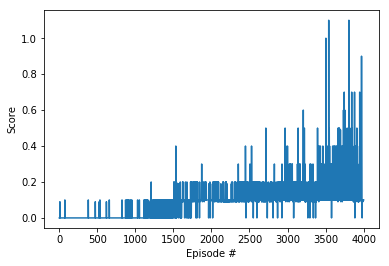

In [21]:
fig = plt.figure()
ax = fig.add_subplot(111)
plt.plot(np.arange(1, len(all_scores)+1), all_scores)
plt.ylabel('Score')
plt.xlabel('Episode #')
plt.show()

In [22]:
# Some more episodes
for i in keep_awake(range(5000)):
    agent.reset()
    episode_score = run_episode(agent, i, 2)
    last_scores.append(episode_score)
    mean_score = np.mean(np.array(last_scores))
    all_scores.append(episode_score)
    print("Episode ", i, " - Score: ", episode_score)
    if i > 0 and i % 20 == 0:
        print("Episode ", i, " - Mean score: ", mean_score)
    if mean_score > max_mean_score:
        max_mean_score = mean_score
        torch.save(agent.actor_online.state_dict(), f'checkpoint_actor.pth')
        torch.save(agent.critic_online.state_dict(), f'checkpoint_critic.pth')
    if i > 100 and mean_score >= MIN_AVG_SCORE:
        print("Problem solved!")
        break

Avg critic losses:  tensor(0.0001, grad_fn=<MeanBackward0>)
Avg actor losses:  tensor(-0.0976, grad_fn=<MeanBackward0>)
Avg critic losses:  tensor(0.0002, grad_fn=<MeanBackward0>)
Avg actor losses:  tensor(-0.1018, grad_fn=<MeanBackward0>)
Avg critic losses:  tensor(0.0001, grad_fn=<MeanBackward0>)
Avg actor losses:  tensor(-0.0969, grad_fn=<MeanBackward0>)
Avg critic losses:  tensor(9.4856e-05, grad_fn=<MeanBackward0>)
Avg actor losses:  tensor(-0.0987, grad_fn=<MeanBackward0>)
Avg critic losses:  tensor(0.0001, grad_fn=<MeanBackward0>)
Avg actor losses:  tensor(-0.1038, grad_fn=<MeanBackward0>)
Avg critic losses:  tensor(0.0001, grad_fn=<MeanBackward0>)
Avg actor losses:  tensor(-0.1036, grad_fn=<MeanBackward0>)
Avg critic losses:  tensor(0.0001, grad_fn=<MeanBackward0>)
Avg actor losses:  tensor(-0.1017, grad_fn=<MeanBackward0>)
Avg critic losses:  tensor(8.2291e-05, grad_fn=<MeanBackward0>)
Avg actor losses:  tensor(-0.0988, grad_fn=<MeanBackward0>)
Avg critic losses:  tensor(0.000

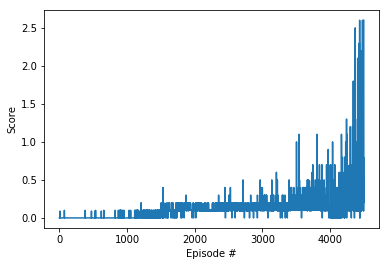

In [23]:
fig = plt.figure()
ax = fig.add_subplot(111)
plt.plot(np.arange(1, len(all_scores)+1), all_scores)
plt.ylabel('Score')
plt.xlabel('Episode #')
plt.show()